In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
from pfss.pfss_module import pfss_solver

In [4]:
fits_file = 'hmi.synoptic_mr_polfil_720s.2282.Mr_polfil.fits'
ps = pfss_solver(fits_file,
                 lmax = 80,
                 n_r  = 400,
                 n_t  = 200,
                 n_p  = 400
                )

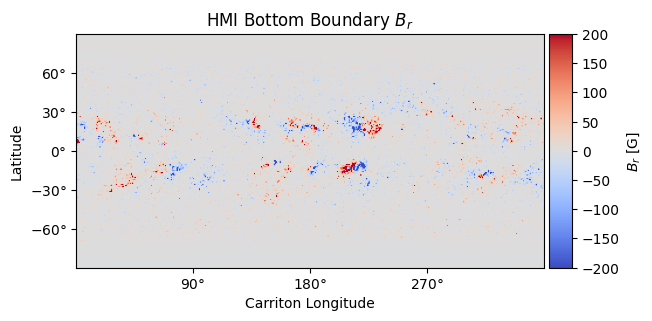

In [4]:
ps.plot_BC(vmin=-200,vmax=200)

In [5]:
Br,Bt,Bp = ps.get_pfss(lmax=120,n1_print=1000,n2_print=1000,n_cores=50)

 ### ======================================================================= ### 
 ###        Step1: Compute the Sphrical harmonics function coefficient       ### 
 ### ======================================================================= ### 
### =========== Computing Alm Blm  ============ ###
#       Available CPU cores:  96                  #
#            Used CPU cores:  50                  #
### =========================================== ###
Progress:      1/14641 tasks completed.  Wall_time:  0.011 min
Progress:   1000/14641 tasks completed.  Wall_time:  0.041 min
Progress:   2000/14641 tasks completed.  Wall_time:  0.068 min
Progress:   3000/14641 tasks completed.  Wall_time:  0.104 min
Progress:   4000/14641 tasks completed.  Wall_time:  0.145 min
Progress:   5000/14641 tasks completed.  Wall_time:  0.193 min
Progress:   6000/14641 tasks completed.  Wall_time:  0.246 min
Progress:   7000/14641 tasks completed.  Wall_time:  0.303 min
Progress:   8000/14641 tasks completed.  W

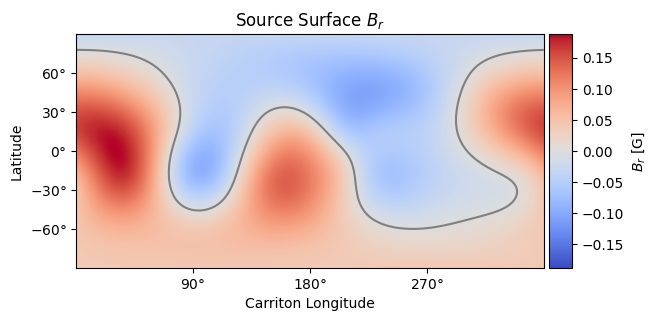

In [9]:
ps.plot_source_surface(grid=False)

In [6]:
devices = ['cuda:0']*1+['cuda:1']*1+['cuda:2']*1+['cuda:3']*1
Brtp = ps.multi_gpu_pfss(devices, load_coef=True)

!!! Build the PFSS model successfully.  Total Time:     29.1 min !!!


In [11]:
Br,Bt,Bp = ps.get_pfss(lmax=80,n1_print=1000,n2_print=100,n_cores=50,fast_mode=True,load_coef=True)

 ### ======================================================================= ### 
 ###        Step1: Compute the Sphrical harmonics function coefficient       ### 
 ### ======================================================================= ### 
 ### ======================================================================= ### 
 ###                      Step2: Building the Brtp field                     ### 
 ### ======================================================================= ### 
Device:  cuda
Progress:      1/3321 tasks completed.  Wall_time:    0.002 min, max Br: -2.0922e-02, min Br:-1.3076e-01
Progress:    100/3321 tasks completed.  Wall_time:    0.349 min, max Br: +8.9103e+00, min Br:-1.7042e+01
Progress:    200/3321 tasks completed.  Wall_time:    0.784 min, max Br: +2.0814e+01, min Br:-3.1156e+01
Progress:    300/3321 tasks completed.  Wall_time:    1.222 min, max Br: +2.7452e+01, min Br:-4.0054e+01
Progress:    400/3321 tasks completed.  Wall_time:    1.689 min, max Br: +

In [26]:
devices = ['cuda:0']*1+['cuda:1']*1+['cuda:2']*1+['cuda:3']
Brtp = ps.multi_gpu_pfss(devices, fast_mode=True, n2_print=10,lmax=80)

!!! Build the PFSS model successfully.  Total Time:     6.93 min !!!


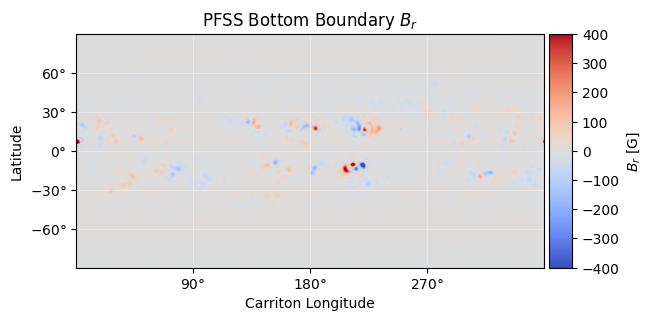

In [31]:
ps.plot_bottom_boundary(vmin=-400,vmax=400)

In [23]:
ps.save_vts()

 Start to save .vts file... 
Time Used:      2.1 min...


In [29]:
ps.save_vtu()

 Start to save .vtu file... 
Time Used:     11.0 min...


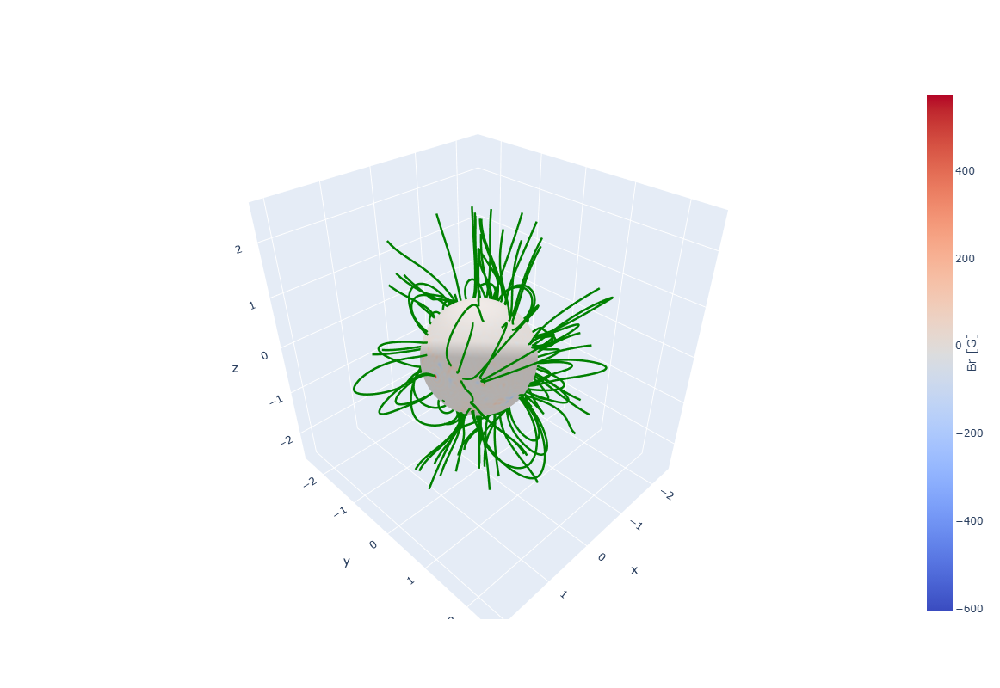

In [22]:
ps.show_maglines()